# CFL stability analysis

In [1]:
from IPython.display import display, Markdown, Latex 

%run src/sps_test_suite.py

import numpy as np 
import src.animation

def analyseStability(
    scheme,
    config,
    generateIC,
    analyticalSolution,
    increaseTimestepFactor,
    increaseTimestepN = 5,
    debug = False,
    waveScheme = None, 
    advection = False,
    potential = None,
):
    NX    = config["resolution"]
    L     = config["domainSize"]
    tEnd  = config["tEnd"]
    dx    = L / NX
    dt    = config["dt"]
    error = np.zeros(increaseTimestepN)
    config["useAdaptiveTimestep"] = False

    dxs = []
    timesteps = []
    vs = []

    for i in range(increaseTimestepN):
        solver = scheme(config, generateIC)
        #solver.setExternalPotentialFunction(potential)
        if waveScheme is not None:
            waveSolver = waveScheme(config, generateIC)
            #waveSolver.setExternalPotentialFunction(potential)
        else:
            waveSolver = None 


        try:
            solver.run()
        except TypeError:
            pass
        if waveSolver is not None:
            waveSolver.run()

        if waveScheme is None:
            if advection:
                ana, _  = analyticalSolution(*solver.grid, solver.dx, solver.t)
            else:
                ana     = np.abs(analyticalSolution(*solver.grid, solver.dx, solver.t)) ** 2
        else:
            ana = np.abs(waveSolver.getPsi())**2

        num = solver.getDensity()

        error[i] = np.mean(np.abs(num - ana))
        timesteps.append(solver.dt)
        dxs.append(solver.dx)
        vs.append(solver.vmax)

        if debug:
            print("dx ", dx, " dt ", np.mean(timesteps))
            print("error [i]: ", i, error[i])
            animation.drawFrame(solver, waveSolver = waveSolver, advection=advection)
            plt.show()

        dt *= increaseTimestepFactor
        config["dt"] = dt
            
    return error, dxs, timesteps, vs 

## Parabolic CFL

In [71]:

def test(x, dx, t, m = 1, hbar = 1, alpha= 1/5, k= 0.1, x0=.5):
    C = np.sqrt(alpha / (alpha + 1.0j * t * hbar/m))
    psi = (
        C
        * np.exp(-((x - x0 - 1.0j * k * alpha) ** 2) / (2 * (alpha + 1.0j * t * hbar/m)))
        * np.exp(-(alpha * k ** 2) / 2)
    )
    return tests.normalise(psi)

def config(c):
    c["usePeriodicBC"] = False
    c["resolution"] = 512
    c["tEnd"] = .001
    c["domainSize"] = 1
    c["xlim"] = [0, 1]
    c["densityYlim"] = [0, 5]
    c["slowDown"] = 2000
    c["dt"] = 1e-7


test_list["travelling gaussian"] = [test, config, None]
c = getBaseConfig()
config(c)
c["gravity"] = 0

c["densityLimiter"] = 2
c["velocityLimiter"] = 0

c["timeOrder"] = 3
c["stencilOrder"] = 3

# Another parabolic test

In [7]:

def cosmo2DConfig(c):
    c["dimension"] = 2
    c["usePeriodicBC"] = True
    c["domainSize"] = 16
    c["resolution"] = 512
    c["tEnd"] = 0.03
    c["slowDown"] = 10
    c["plotPhaseMod2"] = False
    c["phaseYlim"] = [-50, 50]
    c["densityYlim"] = [0, 1]
    c["gravity"] = 1
    c["fps"] = 20
    c["dt"] = 5e-3 / 16

test_list["cosmo 2D"] = [lambda x, y, dx, t, m, hbar: tests.cosmological2D(x, y, dx, t, m, hbar, Lx = 16, Ly = 16, N = 4, eps= 1e-2), cosmo2DConfig, None]


## Velocity CFL

In [2]:

def test(x, dx, t, m = 1, hbar = 1, alpha= 128, k=2, x0=32):
    C = np.sqrt(alpha / (alpha + 1.0j * t * hbar/m))
    psi = (
        C
        * np.exp(-((x - x0 - 1.0j * k * alpha) ** 2) / (2 * (alpha + 1.0j * t * hbar/m)))
        * np.exp(-(alpha * k ** 2) / 2)
    )
    return tests.normalise(psi)

def config(c):
    c["usePeriodicBC"] = False
    c["resolution"] = 128
    c["tEnd"] = 5
    c["domainSize"] = 128
    c["xlim"] = [0, 64]
    c["densityYlim"] = [0, 10]
    c["slowDown"] = 2000
    c["phaseYlim"] = [-100, 100]
    c["dt"] = 1e-2


test_list["fast gaussian"] = [test, config, None]
c = getBaseConfig()
config(c)
c["gravity"] = 0

c["densityLimiter"] = 2
c["velocityLimiter"] = 0

c["timeOrder"] = 3
c["stencilOrder"] = 3
c["C_velocity"] = 1.0
c["centralOrder"] = 2
c["limitHJ"] = False
c["useThirdOrderForward"] = True 
c["plotPhaseMod2"] = False

solver = phase_schemes.HOUpwindScheme(c, test)

t = 0 t_parabolic = 0.16666666666666666 t_velocity = 0.0034722222219810946 t_acceleration = 0.023408229438825284 t_gravity = 10000.0
t = 0.0034722222219810946 t_parabolic = 0.16666666666666666 t_velocity = 0.003545552428660525 t_acceleration = 0.027337387617768435 t_gravity = 10000.0
t = 0.00701777465064162 t_parabolic = 0.16666666666666666 t_velocity = 0.0036930236271611673 t_acceleration = 0.032538809223738856 t_gravity = 10000.0
t = 0.010710798277802787 t_parabolic = 0.16666666666666666 t_velocity = 0.003999931905825682 t_acceleration = 0.035995705706143806 t_gravity = 10000.0
t = 0.014710730183628468 t_parabolic = 0.16666666666666666 t_velocity = 0.004563293389914858 t_acceleration = 0.04129334976832971 t_gravity = 10000.0
t = 0.019274023573543325 t_parabolic = 0.16666666666666666 t_velocity = 0.004598152370937617 t_acceleration = 0.043021192737058726 t_gravity = 10000.0
t = 0.02387217594448094 t_parabolic = 0.16666666666666666 t_velocity = 0.004542418282154569 t_acceleration = 0.0

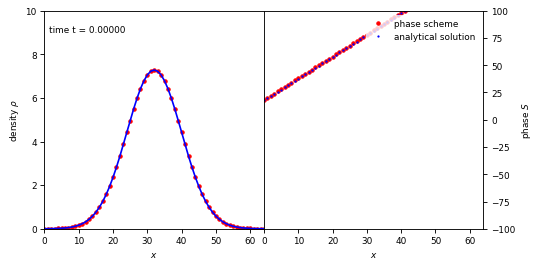

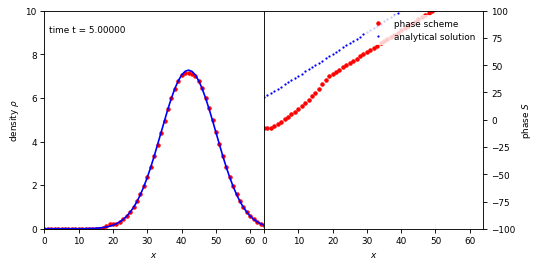

In [111]:
animation.drawFrame(solver, waveSolver=None)
solver.run()
animation.drawFrame(solver)

In [14]:
#test_names_1d  = ['accuracy test']
#test_names  = ["harmonic oscillator coherent state"]
test_names  = ["cosmo 2D"]
#test_names  = ['cosmo 2D']
#test_names = ['periodic gaussian wave packet']#, 'accuracy test 3D']


def hoUpwindT2Config(c):
    c["stencilOrder"] = 2
    c["centralOrder"] = 2
    c["timeOrder"] = 2
    c["slowDown"] = 10
    c["limitHJ"] = False 
    c["useThirdOrderForward"] = False
    c["densityLimiter"] = 2
    c["velocityLimiter"] = 0

def hoUpwindT3Config(c):
    c["stencilOrder"] = 2
    c["centralOrder"] = 2
    c["timeOrder"] = 3
    c["slowDown"] = 10
    c["limitHJ"] = False 
    c["useThirdOrderForward"] = False
    c["densityLimiter"] = 2
    c["velocityLimiter"] = 0

def hoUpwindT4Config(c):
    c["stencilOrder"] = 2
    c["centralOrder"] = 2
    c["timeOrder"] = 4
    c["slowDown"] = 10
    c["limitHJ"] = False 
    c["useThirdOrderForward"] = False
    c["densityLimiter"] = 2
    c["velocityLimiter"] = 0


def hoUpwindT2LimitHJConfig(c):
    c["stencilOrder"] = 2
    c["centralOrder"] = 2
    c["timeOrder"] = 2
    c["slowDown"] = 10
    c["limitHJ"] = True 
    c["useThirdOrderForward"] = False

def hoUpwindT2TOConfig(c):
    c["stencilOrder"] = 2
    c["centralOrder"] = 2
    c["timeOrder"] = 2
    c["slowDown"] = 10
    c["limitHJ"] = False
    c["useThirdOrderForward"] = True

def hoUpwindT2TOFOConfig(c):
    c["stencilOrder"] = 2
    c["centralOrder"] = 4
    c["timeOrder"] = 2
    c["slowDown"] = 10
    c["limitHJ"] = False
    c["useThirdOrderForward"] = True



def hoUpwindT3LimitHJConfig(c):
    c["stencilOrder"] = 2
    c["centralOrder"] = 2
    c["timeOrder"] = 3
    c["slowDown"] = 10
    c["limitHJ"] = True 
    c["useThirdOrderForward"] = False

def hoUpwindT3TOConfig(c):
    c["stencilOrder"] = 2
    c["centralOrder"] = 2
    c["timeOrder"] = 3
    c["slowDown"] = 10
    c["limitHJ"] = False
    c["useThirdOrderForward"] = True

def hoUpwindT3TOFOConfig(c):
    c["stencilOrder"] = 2
    c["centralOrder"] = 4
    c["timeOrder"] = 3
    c["slowDown"] = 10
    c["limitHJ"] = False
    c["useThirdOrderForward"] = True

scheme_list["phase-ho-upwind-t2"]          = [phase_schemes.HOUpwindScheme, hoUpwindT2Config]
scheme_list["phase-ho-upwind-t3"]          = [phase_schemes.HOUpwindScheme, hoUpwindT3Config]
scheme_list["phase-ho-upwind-t4"]          = [phase_schemes.HOUpwindScheme, hoUpwindT4Config]

scheme_list["phase-ho-upwind-t2-limit-hj"] = [phase_schemes.HOUpwindScheme, hoUpwindT2LimitHJConfig]
scheme_list["phase-ho-upwind-t2-to"]       = [phase_schemes.HOUpwindScheme, hoUpwindT2TOConfig]
scheme_list["phase-ho-upwind-t2-tofo"]     = [phase_schemes.HOUpwindScheme, hoUpwindT2TOFOConfig]

scheme_list["phase-ho-upwind-t3-limit-hj"] = [phase_schemes.HOUpwindScheme, hoUpwindT3LimitHJConfig]
scheme_list["phase-ho-upwind-t3-to"]       = [phase_schemes.HOUpwindScheme, hoUpwindT3TOConfig]
scheme_list["phase-ho-upwind-t3-tofo"]     = [phase_schemes.HOUpwindScheme, hoUpwindT3TOFOConfig]


scheme_list["phase-fromm-t2"]          = [phase_schemes.FrommScheme, hoUpwindT2Config]
scheme_list["phase-fromm-t3"]          = [phase_schemes.FrommScheme, hoUpwindT3Config]
scheme_list["phase-fromm-t4"]          = [phase_schemes.FrommScheme, hoUpwindT4Config]

scheme_list["phase-upwind-t2"]          = [phase_schemes.UpwindScheme, hoUpwindT2Config]
scheme_list["phase-upwind-t3"]          = [phase_schemes.UpwindScheme, hoUpwindT3Config]
scheme_list["phase-upwind-t4"]          = [phase_schemes.UpwindScheme, hoUpwindT4Config]

scheme_list["phase-ppm-t2"]          = [phase_schemes.PPMScheme, hoUpwindT2Config]
scheme_list["phase-ppm-t3"]          = [phase_schemes.PPMScheme, hoUpwindT3Config]
scheme_list["phase-ppm-t4"]          = [phase_schemes.PPMScheme, hoUpwindT4Config]

schemes_for_accuracy_test = [#"phase-ho-upwind-t2", 
                             #"phase-ho-upwind-t3", 
                             #"phase-ho-upwind-t4", 
                             #"phase-ho-upwind-t2-limit-hj",
                             #"phase-ho-upwind-t2-to",
                             #"phase-ho-upwind-t2-tofo",
                             #"phase-ho-upwind-t3-limit-hj",
                             "phase-ho-upwind-t3-to",
                             "phase-ho-upwind-t3-tofo"]
                             #"phase-fromm-t2",
                             #"phase-fromm-t3",
                             #"phase-fromm-t4",
                             #"phase-upwind-t2",
                             #"phase-upwind-t3",
                             #"phase-upwind-t4",
                             #"phase-ppm-t2",
                             #"phase-ppm-t3"]
                             #"phase-ppm-t4"]
                             
#, "phase-ho-upwind_leer", "phase-ho-upwind_albada"]
#schemes_for_accuracy_test = ["phase-ho-upwind_albada"]"wave-ftcs2", "wave-ftcs4", 
advection  = False

increaseTimestepFactor = 1.05
increaseTimestepN      = 25

suffix = ""
plotRuns = False

for test_name in test_names:
    test, testConfig, potential = test_list[test_name]

    display(Markdown('#' + " Test: " + test_name))

    truncations_errors = {}

    for scheme_name in schemes_for_accuracy_test:
        scheme, schemeConfig = scheme_list[scheme_name]

        c = getBaseConfig()
        testConfig(c)
        schemeConfig(c)
        c["outputTimestep"] = True

        p, dx, dt, vs = analyseStability(
            scheme,
            c,
            test,
            test,
            increaseTimestepFactor=increaseTimestepFactor,
            increaseTimestepN=increaseTimestepN, 
            debug=plotRuns,
            advection = advection,
            potential = potential,
            waveScheme=wave_schemes.SpectralScheme
        )

        truncations_errors[scheme_name] = {
            "errors": p,
            "dx": dx,
            "dt": dt,
            "v": vs,
        }
        filename = "data/truncation_error_" + test_name.replace(" ", "_") + "_" + scheme_name.replace(" ", "_") + suffix + ".npz"
        print(filename)
        np.savez(filename, **(truncations_errors[scheme_name]))


# Test: cosmo 2D

t = 0.0000000 dt = 0.0003125 a = 1.0000000 
t = 0.0003125 dt = 0.0003125 a = 1.0000000 
t = 0.0006250 dt = 0.0003125 a = 1.0000000 
t = 0.0009375 dt = 0.0003125 a = 1.0000000 
t = 0.0012500 dt = 0.0003125 a = 1.0000000 
t = 0.0015625 dt = 0.0003125 a = 1.0000000 
t = 0.0018750 dt = 0.0003125 a = 1.0000000 
t = 0.0021875 dt = 0.0003125 a = 1.0000000 
t = 0.0025000 dt = 0.0003125 a = 1.0000000 
t = 0.0028125 dt = 0.0003125 a = 1.0000000 
t = 0.0031250 dt = 0.0003125 a = 1.0000000 
t = 0.0034375 dt = 0.0003125 a = 1.0000000 
t = 0.0037500 dt = 0.0003125 a = 1.0000000 
t = 0.0040625 dt = 0.0003125 a = 1.0000000 
t = 0.0043750 dt = 0.0003125 a = 1.0000000 
t = 0.0046875 dt = 0.0003125 a = 1.0000000 
t = 0.0050000 dt = 0.0003125 a = 1.0000000 
t = 0.0053125 dt = 0.0003125 a = 1.0000000 
t = 0.0056250 dt = 0.0003125 a = 1.0000000 
t = 0.0059375 dt = 0.0003125 a = 1.0000000 
t = 0.0062500 dt = 0.0003125 a = 1.0000000 
t = 0.0065625 dt = 0.0003125 a = 1.0000000 
t = 0.0068750 dt = 0.0003125 a =

/home/calab912/Documents/fdm-hybrid-scheme/src/phase_schemes.py:226: RuntimeWarning: invalid value encountered in subtract
  vp = (-2*pm -3*pc+6*pp-1*ppp)/(6*1.0*dx**1)


Finished in 49 time steps
t = 0.0000000 dt = 0.0006497 a = 1.0000000 
t = 0.0006497 dt = 0.0006497 a = 1.0000000 
t = 0.0012993 dt = 0.0006497 a = 1.0000000 
t = 0.0019490 dt = 0.0006497 a = 1.0000000 
t = 0.0025987 dt = 0.0006497 a = 1.0000000 
t = 0.0032483 dt = 0.0006497 a = 1.0000000 
t = 0.0038980 dt = 0.0006497 a = 1.0000000 
t = 0.0045477 dt = 0.0006497 a = 1.0000000 
t = 0.0051973 dt = 0.0006497 a = 1.0000000 
t = 0.0058470 dt = 0.0006497 a = 1.0000000 
t = 0.0064967 dt = 0.0006497 a = 1.0000000 
t = 0.0071463 dt = 0.0006497 a = 1.0000000 
t = 0.0077960 dt = 0.0006497 a = 1.0000000 
t = 0.0084456 dt = 0.0006497 a = 1.0000000 
t = 0.0090953 dt = 0.0006497 a = 1.0000000 
t = 0.0097450 dt = 0.0006497 a = 1.0000000 
t = 0.0103946 dt = 0.0006497 a = 1.0000000 
t = 0.0110443 dt = 0.0006497 a = 1.0000000 
t = 0.0116940 dt = 0.0006497 a = 1.0000000 
t = 0.0123436 dt = 0.0006497 a = 1.0000000 
t = 0.0129933 dt = 0.0006497 a = 1.0000000 
t = 0.0136430 dt = 0.0006497 a = 1.0000000 
t = 0.

/home/calab912/Documents/fdm-hybrid-scheme/src/phase_schemes.py:235: RuntimeWarning: overflow encountered in subtract
  ddensity += (fp - fm) / dx
/home/calab912/Documents/fdm-hybrid-scheme/src/phase_schemes.py:235: RuntimeWarning: overflow encountered in add
  ddensity += (fp - fm) / dx


Finished in 47 time steps
t = 0.0000000 dt = 0.0006821 a = 1.0000000 
t = 0.0006821 dt = 0.0006821 a = 1.0000000 
t = 0.0013643 dt = 0.0006821 a = 1.0000000 
t = 0.0020464 dt = 0.0006821 a = 1.0000000 
t = 0.0027286 dt = 0.0006821 a = 1.0000000 
t = 0.0034107 dt = 0.0006821 a = 1.0000000 
t = 0.0040929 dt = 0.0006821 a = 1.0000000 
t = 0.0047750 dt = 0.0006821 a = 1.0000000 
t = 0.0054572 dt = 0.0006821 a = 1.0000000 
t = 0.0061393 dt = 0.0006821 a = 1.0000000 
t = 0.0068215 dt = 0.0006821 a = 1.0000000 
t = 0.0075036 dt = 0.0006821 a = 1.0000000 
t = 0.0081858 dt = 0.0006821 a = 1.0000000 
t = 0.0088679 dt = 0.0006821 a = 1.0000000 
t = 0.0095501 dt = 0.0006821 a = 1.0000000 
t = 0.0102322 dt = 0.0006821 a = 1.0000000 
t = 0.0109144 dt = 0.0006821 a = 1.0000000 
t = 0.0115965 dt = 0.0006821 a = 1.0000000 
t = 0.0122787 dt = 0.0006821 a = 1.0000000 
t = 0.0129608 dt = 0.0006821 a = 1.0000000 
t = 0.0136430 dt = 0.0006821 a = 1.0000000 
t = 0.0143251 dt = 0.0006821 a = 1.0000000 
t = 0.

/home/calab912/Documents/fdm-hybrid-scheme/src/phase_schemes.py:239: RuntimeWarning: overflow encountered in add
  dphase   += (np.minimum(vp, 0)**2 + np.maximum(vm, 0)**2)/2


Finished in 42 time steps
t = 0.0000000 dt = 0.0007521 a = 1.0000000 
t = 0.0007521 dt = 0.0007521 a = 1.0000000 
t = 0.0015041 dt = 0.0007521 a = 1.0000000 
t = 0.0022562 dt = 0.0007521 a = 1.0000000 
t = 0.0030083 dt = 0.0007521 a = 1.0000000 
t = 0.0037603 dt = 0.0007521 a = 1.0000000 
t = 0.0045124 dt = 0.0007521 a = 1.0000000 
t = 0.0052645 dt = 0.0007521 a = 1.0000000 
t = 0.0060165 dt = 0.0007521 a = 1.0000000 
t = 0.0067686 dt = 0.0007521 a = 1.0000000 
t = 0.0075207 dt = 0.0007521 a = 1.0000000 
t = 0.0082728 dt = 0.0007521 a = 1.0000000 
t = 0.0090248 dt = 0.0007521 a = 1.0000000 
t = 0.0097769 dt = 0.0007521 a = 1.0000000 
t = 0.0105290 dt = 0.0007521 a = 1.0000000 
t = 0.0112810 dt = 0.0007521 a = 1.0000000 
t = 0.0120331 dt = 0.0007521 a = 1.0000000 
t = 0.0127852 dt = 0.0007521 a = 1.0000000 
t = 0.0135372 dt = 0.0007521 a = 1.0000000 
t = 0.0142893 dt = 0.0007521 a = 1.0000000 
t = 0.0150414 dt = 0.0007521 a = 1.0000000 
t = 0.0157934 dt = 0.0007521 a = 1.0000000 
t = 0.

### Travelling Gaussian Parabolic CFL

### Cosmo 2D Parabolic CFL

0.32 1.776690353555349e-08
0.336 1.776758379475651e-08
0.35280000000000006 1.7768537598656384e-08
0.3704400000000001 1.7769437680216216e-08
0.38896200000000014 1.7770415247954075e-08
0.40841010000000016 1.7771282653184664e-08
0.4288306050000002 1.7772258429228458e-08
0.4502721352500002 1.7773390138268277e-08
0.47278574201250023 1.7774692398603706e-08
0.49642502911312525 1.7788804098178853e-08
0.5212462805687815 5.829959394759698e-08
0.5473085945972206 1.6464536940653266e-05
0.5746740243270816 0.0045749659256167285
0.6034077255434357 4.178457431545637e+42
0.6335781118206075 6.874023435945941e+100
0.6652570174116379 1.697422604221606e+53
0.6985198682822198 1.4491462143755048e+39
0.7334458616963309 1.7934086552985907e+82
0.7701181547811474 2.1820634716790382e+161
0.8086240625202048 9.00074283245486e+158
0.849055265646215 5.194109744665704e+174
0.8915080289285258 1.3031044942082167e+194
0.9360834303749521 8.701096333420786e+219
0.9828876018936997 1.317042137603145e+243
1.0320319819883848 4

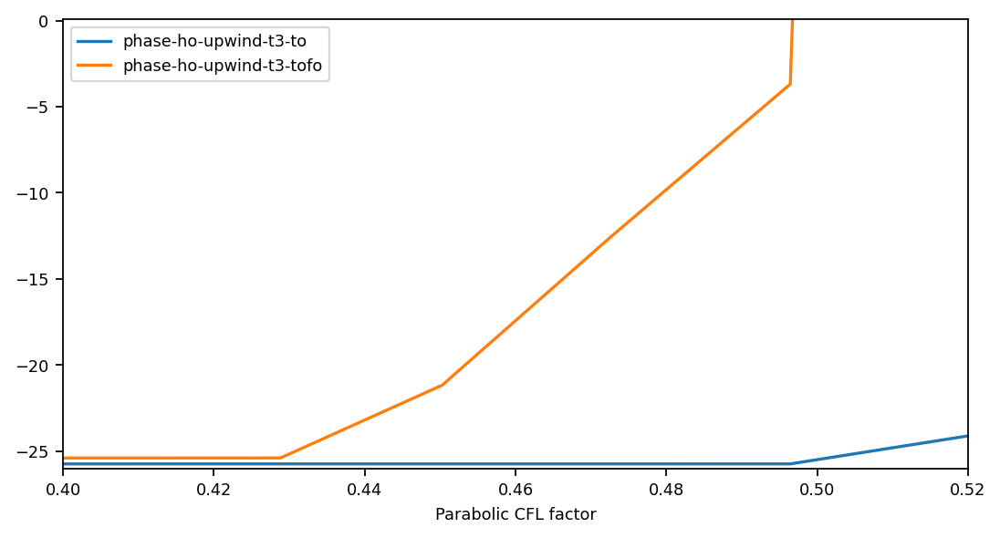

In [17]:

import matplotlib.pyplot as plt 

plt.figure(figsize=(8,4), dpi=160)
plt.xlabel("Parabolic CFL factor")
plt.ylim([-26, .1])
plt.xlim([0.4, .52])
ax = plt.subplot(111)


for key in truncations_errors.keys():
    #truncations_errors = np.load(filename)
    dt = np.array(truncations_errors[key]["dt"])
    dx = np.array(truncations_errors[key]["dx"])
    vs = np.array(truncations_errors[key]["v"])
    
    errors = np.array(truncations_errors[key]["errors"])
    xx = dt/(dx**2)
    for i, cfl in enumerate(xx):
        print(cfl, errors[i])
    ax.plot(xx, np.log(errors)/np.log(2), label=key)

plt.legend()
plt.show()

0.524288 7.740970225593966e-05
0.5295308799999999 9.163198510327036e-06
0.5348261887999999 1.7118655388357155e-05
0.5401744506879999 2.8938688842511216e-05
0.5455761951948799 4.430542360058071e-05
0.5510319571468287 6.256934999312705e-05
0.556542276718297 7.09918948506231e-06
0.56210769948548 3.5055404846438304e-05
0.5677287764803348 6.476964960776011e-05
0.5734060642451382 1.9835632159560876e-05
0.5791401248875896 5.8523837035184696e-05
0.5849315261364655 1.942706093700415e-05
0.5907808413978302 6.566386543535585e-05
0.5966886498118085 3.446446081797989e-05
0.6026555363099265 8.508003219173676e-05
0.6086820916730258 6.345182670882702e-05
0.6147689125897561 4.221728777080881e-05
0.6209166017156537 2.275958159854398e-05
0.6271257677328101 6.012386951306135e-06
0.6333970254101382 8.051692807474856e-05
0.6397309956642396 7.380787002748374e-05
0.6461283056208821 6.990656128979983e-05
0.6525895886770909 6.910703504637173e-05
0.6591154845638618 7.151784948951198e-05
0.6657066394095005 7.7056

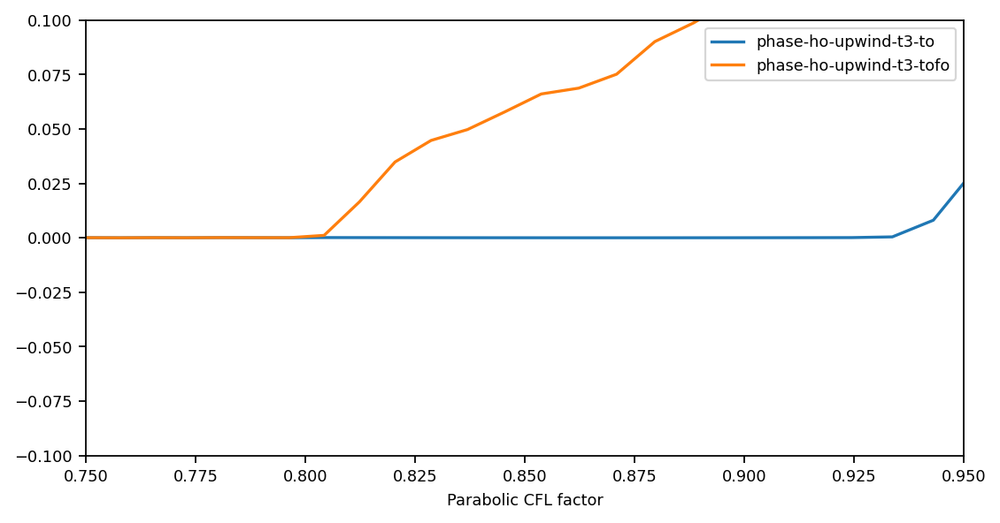

In [90]:

import matplotlib.pyplot as plt 

plt.figure(figsize=(8,4), dpi=160)
plt.xlabel("Parabolic CFL factor")
plt.ylim([-.1, .1])
plt.xlim([0.75, .95])
ax = plt.subplot(111)


for key in truncations_errors.keys():
    #truncations_errors = np.load(filename)
    dt = np.array(truncations_errors[key]["dt"])
    dx = np.array(truncations_errors[key]["dx"])
    vs = np.array(truncations_errors[key]["v"])
    
    errors = np.array(truncations_errors[key]["errors"])
    xx = dt/(dx**2)
    for i, cfl in enumerate(xx):
        print(cfl, errors[i])
    ax.plot(xx, errors, label=key)

plt.legend()
plt.show()

### Fast Gaussian Velocity CFL

[1.36967013e-002 1.38287386e-002 1.38703416e-002 1.42626659e-002
 1.42649312e-002 1.43598819e-002 1.48692241e-002 1.53403816e-002
 1.50718617e-002 1.21934712e+148 1.10846563e+149 7.08792201e+203
 3.44230782e+144 7.59904356e+144 1.19075292e+145 8.33546327e+147
 8.29939107e+146 4.62700065e+150 3.41742461e+150 4.54627144e+154
 3.25949082e+157 2.42887590e+160 3.17503292e+160 2.76850541e+164
 6.58779225e+168 5.97258257e+170 6.92419235e+168 4.72920243e+174
 3.50220393e+175 7.39685992e+178 3.37078970e+182 3.77319899e+186
 1.77654899e+186 3.73840818e+189 9.36516643e+192 4.31405257e+192
 5.94758378e+196 6.62168033e+197 1.56917518e+198 1.62966798e+203]
[1.35482622e-002 1.35986156e-002 1.38004239e-002 1.40514965e-002
 1.39101320e-002 1.41466611e-002 1.41874986e-002 1.44242573e-002
 1.57585160e-002 4.72934104e-002 1.21078542e+149 3.63910176e+177
 3.30668801e+144 2.81417325e+145 2.42755370e+145 5.61101531e+145
 5.48103066e+147 4.59876692e+150 2.91822380e+150 4.63160460e+154
 3.26116902e+157 2.46433

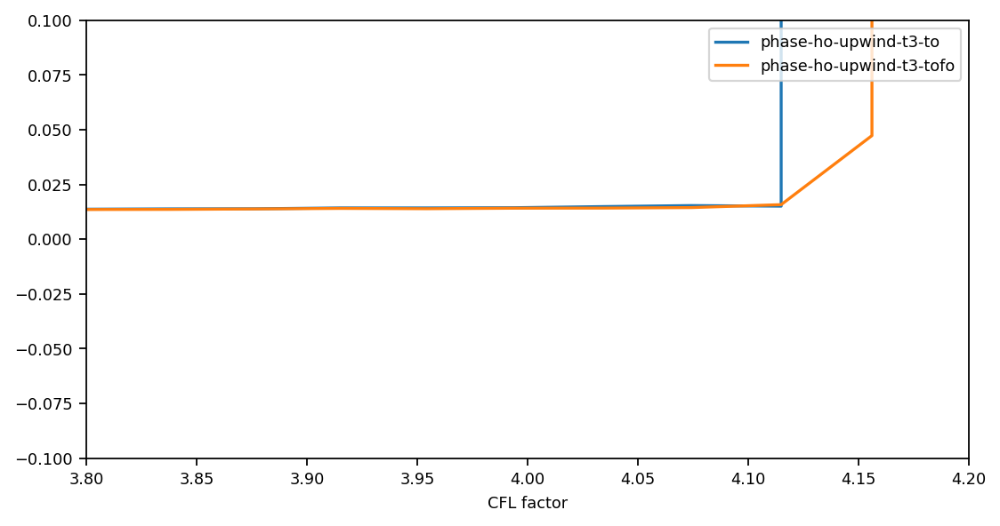

In [18]:

import matplotlib.pyplot as plt 

plt.figure(figsize=(8,4), dpi=160)
plt.xlabel("CFL factor")
plt.ylim([-.1, .1])
plt.xlim([3.8, 4.2])
ax = plt.subplot(111)


for key in truncations_errors.keys():
    #truncations_errors = np.load(filename)
    dt = np.array(truncations_errors[key]["dt"])
    dx = np.array(truncations_errors[key]["dx"])
    vs = np.array(truncations_errors[key]["v"])
    
    errors = np.array(truncations_errors[key]["errors"])
    xx = dt#dt/(dx/(2 * (vs + 1e-8)))
    print(errors)
    ax.plot(xx, errors, label=key)

plt.savefig("plots/velocity_cfl.png")
plt.legend()

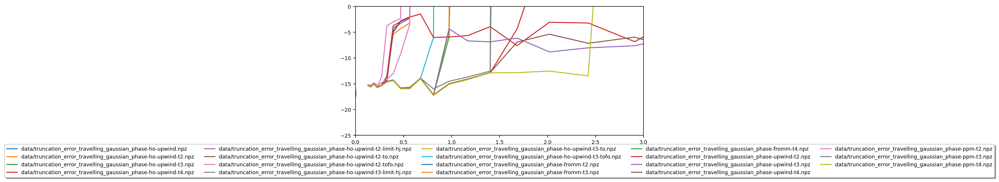

In [31]:

import matplotlib.pyplot as plt 
import glob
path = "data/truncation_error_travelling_gaussian_*.npz"


plt.figure(figsize=(8,4), dpi=160)
plt.xlabel("CFL factor")
plt.ylim([-25, 0])
plt.xlim([0, 3])
ax = plt.subplot(111)


# Shrink current axis's height by 10% on the bottom
box = ax.get_position()
ax.set_position([box.x0, box.y0 + box.height * 0.1,
                 box.width, box.height * 0.9])

for filename in glob.glob(path):
    truncations_errors = np.load(filename)
    dt = truncations_errors.get("dt")
    dx = truncations_errors.get("dx")
    errors = truncations_errors.get("errors")
    xx = dt / dx**2
    ax.plot(xx, np.log(errors)/np.log(2), label=filename)


ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
          fancybox=True, shadow=True, ncol=5)

# Error analysis

In [57]:
import numpy as np 
import src.animation

def analyseError(
    scheme,
    config,
    generateIC,
    analyticalSolution,
    N=5,
    increaseSpatialResolution = 2, 
    increaseTemporalResolution = 1, 
    debug=False,
    waveScheme = None, 
    advection = False,
    potential = None,
):
    NX    = config["resolution"]
    L     = config["domainSize"]
    tEnd  = config["tEnd"]
    dx    = L / NX
    dt    = config["dt"]
    error = np.zeros(N)

    resolutions = []
    average_timesteps = []

    for i in range(N):
        config["resolution"] = NX
        solver = scheme(config, generateIC)
        #solver.setExternalPotentialFunction(potential)
        if waveScheme is not None:
            waveSolver = waveScheme(config, generateIC)
            #waveSolver.setExternalPotentialFunction(potential)
        else:
            waveSolver = None 

        dx = solver.dx 
        nt = 0
        timesteps = [0]
        solver.run()
        if waveSolver is not None:
            waveSolver.run()

        if waveScheme is None:
            if advection:
                ana, _  = analyticalSolution(*solver.grid, solver.dx, solver.t)
            else:
                ana = np.abs(analyticalSolution(*solver.grid, solver.dx, solver.t)) ** 2
        else:
            ana = np.abs(waveSolver.getPsi())**2

        num = solver.getDensity()

        error[i] = np.mean(np.abs(num - ana))
        resolutions.append(dx)
        average_timesteps.append(np.mean(timesteps))

        if debug:
            print("dx ", dx, " dt ", np.mean(timesteps))
            print("error [i]: ", i, error[i])
            animation.drawFrame(solver, waveSolver = waveSolver, advection=advection)
            plt.show()

        NX *= increaseSpatialResolution
        NX = int(NX)
        dt /= increaseTemporalResolution
            
    return error, resolutions, average_timesteps

In [69]:
N = 3
#test_names_1d  = ['accuracy test']
#test_names  = ["harmonic oscillator coherent state"]
test_names  = ["travelling gaussian"]
#schemes_for_accuracy_test = ["phase-ho-upwind_albada"]"wave-ftcs2", "wave-ftcs4", 
advection  = False
waveScheme = wave_schemes.SpectralScheme

increaseSpatialResolution  = 2
increaseTemporalResolution = 1 
suffix = ""
plotRuns = False

for test_name in test_names:
    test, testConfig, potential = test_list[test_name]

    display(Markdown('#' + " Test: " + test_name))

    truncations_errors = {}

    for scheme_name in schemes_for_accuracy_test:
        scheme, schemeConfig = scheme_list[scheme_name]

        c = getBaseConfig()
        testConfig(c)
        schemeConfig(c)
        c["tEnd"] = 0.001
        c["C_velocity"] = 0.1

        p, dx, dt = analyseError(
            scheme,
            c,
            test,
            test,
            N=N,
            increaseTemporalResolution = increaseTemporalResolution, 
            increaseSpatialResolution = increaseSpatialResolution,
            debug=plotRuns,
            waveScheme= waveScheme,
            advection = advection,
            potential = potential
        )

        truncations_errors[scheme_name] = {
            "errors": p,
            "dx": dx,
            "dt": dt
        }
        filename = "data/truncation_error_" + test_name.replace(" ", "_") + "_" + scheme_name.replace(" ", "_") + suffix + ".npz"
        print(filename)
        np.savez(filename, **(truncations_errors[scheme_name]))


# Test: travelling gaussian

t = 0 t_parabolic = 6.357828776041666e-07 t_velocity = 3.7705115815557855e-06 t_acceleration = 0.00010833988207521969 t_gravity = 10000.0
t = 6.357828776041666e-07 t_parabolic = 6.357828776041666e-07 t_velocity = 3.828693850512062e-06 t_acceleration = 0.00011242085080092708 t_gravity = 10000.0
t = 1.2715657552083333e-06 t_parabolic = 6.357828776041666e-07 t_velocity = 3.8286960803297445e-06 t_acceleration = 0.00011242091488535592 t_gravity = 10000.0
t = 1.9073486328125e-06 t_parabolic = 6.357828776041666e-07 t_velocity = 3.828698310227556e-06 t_acceleration = 0.00011242097897101027 t_gravity = 10000.0
t = 2.5431315104166665e-06 t_parabolic = 6.357828776041666e-07 t_velocity = 3.828700540205491e-06 t_acceleration = 0.00011242104305788996 t_gravity = 10000.0
t = 3.178914388020833e-06 t_parabolic = 6.357828776041666e-07 t_velocity = 3.8287027702635475e-06 t_acceleration = 0.00011242110714599465 t_gravity = 10000.0
t = 3.8146972656249996e-06 t_parabolic = 6.357828776041666e-07 t_velocity =

[-12.38070176 -12.56133323  -8.37963541]
[-13.33350807 -13.68536311 -13.78084932]
[-13.81699211 -14.4407453  -14.49936349]
[-12.38307077 -12.56170953  -6.78874071]
[-12.38263014 -12.56181241  -6.00066037]
[-13.33795161 -13.68617135 -13.78225321]
[-13.33561197 -13.68594378 -13.78170795]


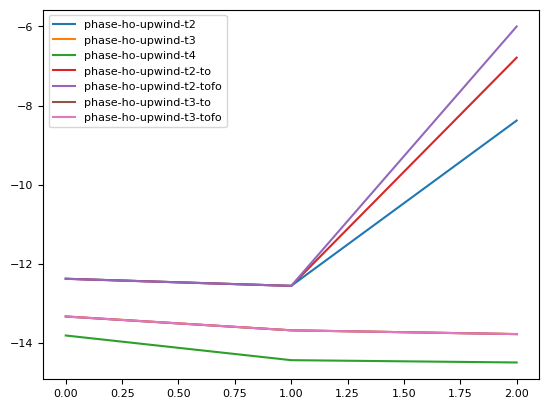

In [70]:

import matplotlib.pyplot as plt 

for key in truncations_errors.keys(): 
    print(np.log(truncations_errors[key]["errors"])/np.log(2))

    xx = np.arange(len(truncations_errors[key]["errors"]))
    plt.plot(np.log(truncations_errors[key]["errors"])/np.log(2), label=key)
    #plt.plot(np.log(truncations_errors[key]["errors"][0]*1/2**(3*xx))/np.log(2), label=key + "log2")
plt.legend()

[ -8.58899741  -9.59712416 -10.58694325]
[ -7.98723927  -9.01092266 -10.0130613 ]
[-7.55314157 -8.58976384 -9.60095185]
[ -8.58901027  -9.60298267 -10.58271484]
[ -8.58901471  -9.60305903 -10.58336921]
[ -7.98683613  -9.01477984 -10.01027533]
[ -7.98683923  -9.01483059 -10.01071479]


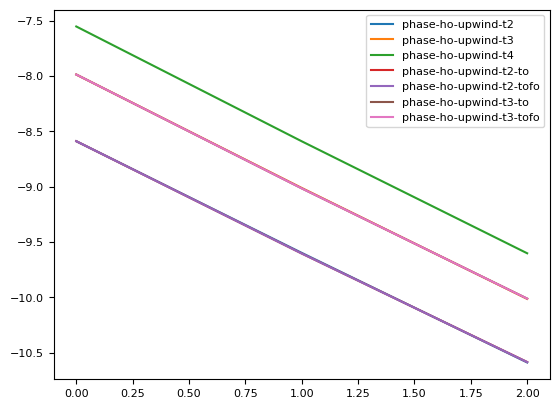

In [66]:

import matplotlib.pyplot as plt 

for key in truncations_errors.keys(): 
    print(np.log(truncations_errors[key]["errors"])/np.log(2))

    xx = np.arange(len(truncations_errors[key]["errors"]))
    plt.plot(np.log(truncations_errors[key]["errors"])/np.log(2), label=key)
    #plt.plot(np.log(truncations_errors[key]["errors"][0]*1/2**(3*xx))/np.log(2), label=key + "log2")
plt.legend()